In [1]:
from __future__ import absolute_import, division, print_function, unicode_literals
import requests
import pandas as pd
from bs4 import BeautifulSoup
from urllib.request import build_opener
from urllib.request import install_opener
import os
import pathlib
from os import listdir
from os.path import isfile, join

from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras import metrics
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation, Conv2D, MaxPooling2D, Flatten,Dropout,BatchNormalization,AveragePooling2D,concatenate,Input, concatenate, GlobalAveragePooling2D
from tensorflow.keras.models import Model,load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.utils import plot_model
from sklearn.model_selection import train_test_split

In [2]:
# physical_devices = tf.config.experimental.list_physical_devices('GPU') 
# for physical_device in physical_devices: 
#     tf.config.experimental.set_memory_growth(physical_device, True)

In [3]:
print(tf.__version__)

2.2.0


In [4]:
# from tensorflow.python.client import device_lib
# print(device_lib.list_local_devices())

# count how many images in each category

In [5]:
folder_name_list = ['001_Bulbasaur', '002_Ivysaur', '003_Venusaur', '004_Charmander', '005_Charmeleon',
 '006_Charizard', '007_Squirtle', '008_Wartortle', '009_Blastoise', '010_Caterpie', '011_Metapod',
 '012_Butterfree', '013_Weedle', '014_Kakuna', '015_Beedrill', '016_Pidgey', '017_Pidgeotto', '018_Pidgeot',
 '019_Rattata', '020_Raticate', '021_Spearow', '022_Fearow', '023_Ekans', '024_Arbok', '025_Pikachu', '026_Raichu',
 '027_Sandshrew', '028_Sandslash', '029_Nidoran♀', '030_Nidorina', '031_Nidoqueen', '032_Nidoran♂', '033_Nidorino',
 '034_Nidoking', '035_Clefairy', '036_Clefable', '037_Vulpix', '038_Ninetales', '039_Jigglypuff', '040_Wigglytuff',
 '041_Zubat', '042_Golbat', '043_Oddish', '044_Gloom', '045_Vileplume', '046_Paras', '047_Parasect', '048_Venonat',
 '049_Venomoth', '050_Diglett', '051_Dugtrio', '052_Meowth', '053_Persian', '054_Psyduck', '055_Golduck', '056_Mankey',
 '057_Primeape', '058_Growlithe', '059_Arcanine', '060_Poliwag', '061_Poliwhirl', '062_Poliwrath', '063_Abra',
 '064_Kadabra', '065_Alakazam', '066_Machop', '067_Machoke', '068_Machamp', '069_Bellsprout', '070_Weepinbell',
 '071_Victreebel', '072_Tentacool', '073_Tentacruel', '074_Geodude', '075_Graveler', '076_Golem', '077_Ponyta',
 '078_Rapidash', '079_Slowpoke', '080_Slowbro', '081_Magnemite', '082_Magneton', "083_Farfetch'd", '084_Doduo',
 '085_Dodrio', '086_Seel', '087_Dewgong', '088_Grimer', '089_Muk', '090_Shellder', '091_Cloyster', '092_Gastly',
 '093_Haunter', '094_Gengar', '095_Onix', '096_Drowzee', '097_Hypno', '098_Krabby', '099_Kingler', '100_Voltorb',
 '101_Electrode', '102_Exeggcute', '103_Exeggutor', '104_Cubone', '105_Marowak', '106_Hitmonlee', '107_Hitmonchan',
 '108_Lickitung', '109_Koffing', '110_Weezing', '111_Rhyhorn', '112_Rhydon', '113_Chansey', '114_Tangela',
 '115_Kangaskhan', '116_Horsea', '117_Seadra', '118_Goldeen', '119_Seaking', '120_Staryu', '121_Starmie',
 '122_Mr. Mime', '123_Scyther', '124_Jynx', '125_Electabuzz', '126_Magmar', '127_Pinsir', '128_Tauros',
 '129_Magikarp', '130_Gyarados', '131_Lapras', '132_Ditto', '133_Eevee', '134_Vaporeon', '135_Jolteon',
 '136_Flareon', '137_Porygon', '138_Omanyte', '139_Omastar', '140_Kabuto', '141_Kabutops', '142_Aerodactyl',
 '143_Snorlax', '144_Articuno', '145_Zapdos', '146_Moltres', '147_Dratini', '148_Dragonair', '149_Dragonite',
 '150_Mewtwo', '151_Mew', '152_Chikorita', '153_Bayleef', '154_Meganium', '155_Cyndaquil', '156_Quilava', '157_Typhlosion',
 '158_Totodile', '159_Croconaw', '160_Feraligatr', '161_Sentret', '162_Furret', '163_Hoothoot', '164_Noctowl',
 '165_Ledyba', '166_Ledian', '167_Spinarak', '168_Ariados', '169_Crobat', '170_Chinchou', '171_Lanturn', '172_Pichu',
 '173_Cleffa', '174_Igglybuff', '175_Togepi', '176_Togetic', '177_Natu', '178_Xatu', '179_Mareep', '180_Flaaffy',
 '181_Ampharos', '182_Bellossom', '183_Marill', '184_Azumarill', '185_Sudowoodo', '186_Politoed', '187_Hoppip',
 '188_Skiploom', '189_Jumpluff', '190_Aipom', '191_Sunkern', '192_Sunflora', '193_Yanma', '194_Wooper', '195_Quagsire',
 '196_Espeon', '197_Umbreon', '198_Murkrow', '199_Slowking', '200_Misdreavus', '201_Unown', '202_Wobbuffet', '203_Girafarig',
 '204_Pineco', '205_Forretress', '206_Dunsparce', '207_Gligar', '208_Steelix', '209_Snubbull', '210_Granbull',
 '211_Qwilfish', '212_Scizor', '213_Shuckle', '214_Heracross', '215_Sneasel', '216_Teddiursa', '217_Ursaring',
 '218_Slugma', '219_Magcargo', '220_Swinub', '221_Piloswine', '222_Corsola', '223_Remoraid', '224_Octillery',
 '225_Delibird', '226_Mantine', '227_Skarmory', '228_Houndour', '229_Houndoom', '230_Kingdra', '231_Phanpy',
 '232_Donphan', '233_Porygon2', '234_Stantler', '235_Smeargle', '236_Tyrogue', '237_Hitmontop', '238_Smoochum',
 '239_Elekid', '240_Magby', '241_Miltank', '242_Blissey', '243_Raikou', '244_Entei', '245_Suicune', '246_Larvitar',
 '247_Pupitar', '248_Tyranitar', '249_Lugia', '250_Ho-Oh', '251_Celebi', '252_Treecko', '253_Grovyle', '254_Sceptile',
 '255_Torchic', '256_Combusken', '257_Blaziken', '258_Mudkip', '259_Marshtomp', '260_Swampert', '261_Poochyena',
 '262_Mightyena', '263_Zigzagoon', '264_Linoone', '265_Wurmple', '266_Silcoon', '267_Beautifly', '268_Cascoon',
 '269_Dustox', '270_Lotad', '271_Lombre', '272_Ludicolo', '273_Seedot', '274_Nuzleaf', '275_Shiftry', '276_Taillow',
 '277_Swellow', '278_Wingull', '279_Pelipper', '280_Ralts', '281_Kirlia', '282_Gardevoir', '283_Surskit', '284_Masquerain',
 '285_Shroomish', '286_Breloom', '287_Slakoth', '288_Vigoroth', '289_Slaking', '290_Nincada', '291_Ninjask',
 '292_Shedinja', '293_Whismur', '294_Loudred', '295_Exploud', '296_Makuhita', '297_Hariyama', '298_Azurill',
 '299_Nosepass', '300_Skitty', '301_Delcatty', '302_Sableye', '303_Mawile', '304_Aron', '305_Lairon', '306_Aggron',
 '307_Meditite', '308_Medicham', '309_Electrike', '310_Manectric', '311_Plusle', '312_Minun', '313_Volbeat',
 '314_Illumise', '315_Roselia', '316_Gulpin', '317_Swalot', '318_Carvanha', '319_Sharpedo', '320_Wailmer',
 '321_Wailord', '322_Numel', '323_Camerupt', '324_Torkoal', '325_Spoink', '326_Grumpig', '327_Spinda',
 '328_Trapinch', '329_Vibrava', '330_Flygon', '331_Cacnea', '332_Cacturne', '333_Swablu', '334_Altaria', '335_Zangoose',
 '336_Seviper', '337_Lunatone', '338_Solrock', '339_Barboach', '340_Whiscash', '341_Corphish', '342_Crawdaunt',
 '343_Baltoy', '344_Claydol', '345_Lileep', '346_Cradily', '347_Anorith', '348_Armaldo', '349_Feebas', '350_Milotic',
 '351_Castform', '352_Kecleon', '353_Shuppet', '354_Banette', '355_Duskull', '356_Dusclops', '357_Tropius', '358_Chimecho',
 '359_Absol', '360_Wynaut', '361_Snorunt', '362_Glalie', '363_Spheal', '364_Sealeo', '365_Walrein', '366_Clamperl',
 '367_Huntail', '368_Gorebyss', '369_Relicanth', '370_Luvdisc', '371_Bagon', '372_Shelgon', '373_Salamence', '374_Beldum',
 '375_Metang', '376_Metagross', '377_Regirock', '378_Regice', '379_Registeel', '380_Latias', '381_Latios', '382_Kyogre',
 '383_Groudon', '384_Rayquaza', '385_Jirachi', '386_Deoxys', '387_Turtwig', '388_Grotle', '389_Torterra', '390_Chimchar',
 '391_Monferno', '392_Infernape', '393_Piplup', '394_Prinplup', '395_Empoleon', '396_Starly', '397_Staravia', '398_Staraptor',
 '399_Bidoof', '400_Bibarel', '401_Kricketot', '402_Kricketune', '403_Shinx', '404_Luxio', '405_Luxray',
 '406_Budew', '407_Roserade', '408_Cranidos', '409_Rampardos', '410_Shieldon', '411_Bastiodon', '412_Burmy', '413_Wormadam',
 '414_Mothim', '415_Combee', '416_Vespiquen', '417_Pachirisu', '418_Buizel', '419_Floatzel', '420_Cherubi', '421_Cherrim',
 '422_Shellos', '423_Gastrodon', '424_Ambipom', '425_Drifloon', '426_Drifblim', '427_Buneary', '428_Lopunny',
 '429_Mismagius', '430_Honchkrow', '431_Glameow', '432_Purugly', '433_Chingling', '434_Stunky', '435_Skuntank',
 '436_Bronzor', '437_Bronzong', '438_Bonsly', '439_Mime Jr.', '440_Happiny', '441_Chatot', '442_Spiritomb', '443_Gible',
 '444_Gabite', '445_Garchomp', '446_Munchlax', '447_Riolu', '448_Lucario', '449_Hippopotas', '450_Hippowdon', '451_Skorupi',
 '452_Drapion', '453_Croagunk', '454_Toxicroak', '455_Carnivine', '456_Finneon', '457_Lumineon', '458_Mantyke',
 '459_Snover', '460_Abomasnow', '461_Weavile', '462_Magnezone', '463_Lickilicky', '464_Rhyperior', '465_Tangrowth',
 '466_Electivire', '467_Magmortar', '468_Togekiss', '469_Yanmega', '470_Leafeon', '471_Glaceon', '472_Gliscor', '473_Mamoswine',
 '474_Porygon-Z', '475_Gallade', '476_Probopass', '477_Dusknoir', '478_Froslass', '479_Rotom', '480_Uxie', '481_Mesprit',
 '482_Azelf', '483_Dialga', '484_Palkia', '485_Heatran', '486_Regigigas', '487_Giratina', '488_Cresselia', '489_Phione',
 '490_Manaphy', '491_Darkrai', '492_Shaymin', '493_Arceus', '494_Victini', '495_Snivy', '496_Servine', '497_Serperior', '498_Tepig',
 '499_Pignite', '500_Emboar', '501_Oshawott', '502_Dewott', '503_Samurott', '504_Patrat', '505_Watchog',
 '506_Lillipup', '507_Herdier', '508_Stoutland', '509_Purrloin', '510_Liepard', '511_Pansage', '512_Simisage',
 '513_Pansear', '514_Simisear', '515_Panpour', '516_Simipour', '517_Munna', '518_Musharna', '519_Pidove', '520_Tranquill',
 '521_Unfezant', '522_Blitzle', '523_Zebstrika', '524_Roggenrola', '525_Boldore', '526_Gigalith', '527_Woobat',
 '528_Swoobat', '529_Drilbur', '530_Excadrill', '531_Audino', '532_Timburr', '533_Gurdurr', '534_Conkeldurr',
 '535_Tympole', '536_Palpitoad', '537_Seismitoad', '538_Throh', '539_Sawk', '540_Sewaddle', '541_Swadloon', '542_Leavanny',
 '543_Venipede', '544_Whirlipede', '545_Scolipede', '546_Cottonee', '547_Whimsicott', '548_Petilil', '549_Lilligant', 
 '550_Basculin', '551_Sandile', '552_Krokorok', '553_Krookodile', '554_Darumaka', '555_Darmanitan', '556_Maractus',
 '557_Dwebble', '558_Crustle', '559_Scraggy', '560_Scrafty', '561_Sigilyph', '562_Yamask', '563_Cofagrigus',
 '564_Tirtouga', '565_Carracosta', '566_Archen', '567_Archeops', '568_Trubbish', '569_Garbodor', '570_Zorua', '571_Zoroark',
 '572_Minccino', '573_Cinccino', '574_Gothita', '575_Gothorita', '576_Gothitelle', '577_Solosis',
 '578_Duosion', '579_Reuniclus', '580_Ducklett', '581_Swanna', '582_Vanillite', '583_Vanillish', '584_Vanilluxe',
 '585_Deerling', '586_Sawsbuck', '587_Emolga', '588_Karrablast', '589_Escavalier', '590_Foongus', '591_Amoonguss',
 '592_Frillish', '593_Jellicent', '594_Alomomola', '595_Joltik', '596_Galvantula', '597_Ferroseed', '598_Ferrothorn',
 '599_Klink', '600_Klang', '601_Klinklang', '602_Tynamo', '603_Eelektrik', '604_Eelektross', '605_Elgyem',
 '606_Beheeyem', '607_Litwick', '608_Lampent', '609_Chandelure', '610_Axew', '611_Fraxure', '612_Haxorus', '613_Cubchoo',
 '614_Beartic', '615_Cryogonal', '616_Shelmet', '617_Accelgor', '618_Stunfisk', '619_Mienfoo', '620_Mienshao',
 '621_Druddigon', '622_Golett', '623_Golurk', '624_Pawniard', '625_Bisharp', '626_Bouffalant', '627_Rufflet',
 '628_Braviary', '629_Vullaby', '630_Mandibuzz', '631_Heatmor', '632_Durant', '633_Deino', '634_Zweilous',
 '635_Hydreigon', '636_Larvesta', '637_Volcarona', '638_Cobalion', '639_Terrakion', '640_Virizion', '641_Tornadus',
 '642_Thundurus', '643_Reshiram', '644_Zekrom', '645_Landorus', '646_Kyurem', '647_Keldeo', '648_Meloetta', '649_Genesect',
 '650_Chespin', '651_Quilladin', '652_Chesnaught', '653_Fennekin', '654_Braixen', '655_Delphox', '656_Froakie',
 '657_Frogadier', '658_Greninja', '659_Bunnelby', '660_Diggersby', '661_Fletchling', '662_Fletchinder',
 '663_Talonflame', '664_Scatterbug', '665_Spewpa', '666_Vivillon', '667_Litleo', '668_Pyroar', '669_Flabébé',
 '670_Floette', '671_Florges', '672_Skiddo', '673_Gogoat', '674_Pancham', '675_Pangoro', '676_Furfrou', '677_Espurr',
 '678_Meowstic', '679_Honedge', '680_Doublade', '681_Aegislash', '682_Spritzee', '683_Aromatisse', '684_Swirlix',
 '685_Slurpuff', '686_Inkay', '687_Malamar', '688_Binacle', '689_Barbaracle', '690_Skrelp', '691_Dragalge', '692_Clauncher',
 '693_Clawitzer', '694_Helioptile', '695_Heliolisk', '696_Tyrunt', '697_Tyrantrum', '698_Amaura', '699_Aurorus', 
 '700_Sylveon', '701_Hawlucha', '702_Dedenne', '703_Carbink', '704_Goomy', '705_Sliggoo', '706_Goodra', '707_Klefki',
 '708_Phantump', '709_Trevenant', '710_Pumpkaboo', '711_Gourgeist', '712_Bergmite', '713_Avalugg',
 '714_Noibat', '715_Noivern', '716_Xerneas', '717_Yveltal', '718_Zygarde', '719_Diancie', '720_Hoopa', '721_Volcanion',
 '722_Rowlet', '723_Dartrix', '724_Decidueye', '725_Litten', '726_Torracat', '727_Incineroar', '728_Popplio',
 '729_Brionne', '730_Primarina', '731_Pikipek', '732_Trumbeak', '733_Toucannon', '734_Yungoos', '735_Gumshoos',
 '736_Grubbin', '737_Charjabug', '738_Vikavolt', '739_Crabrawler', '740_Crabominable', '741_Oricorio', '742_Cutiefly',
 '743_Ribombee', '744_Rockruff', '745_Lycanroc', '746_Wishiwashi', '747_Mareanie', '748_Toxapex', '749_Mudbray',
 '750_Mudsdale', '751_Dewpider', '752_Araquanid', '753_Fomantis', '754_Lurantis', '755_Morelull', '756_Shiinotic',
 '757_Salandit', '758_Salazzle', '759_Stufful', '760_Bewear', '761_Bounsweet', '762_Steenee', '763_Tsareena',
 '764_Comfey', '765_Oranguru', '766_Passimian', '767_Wimpod', '768_Golisopod', '769_Sandygast', '770_Palossand',
 '771_Pyukumuku', '772_Type_Null', '773_Silvally', '774_Minior', '775_Komala', '776_Turtonator', '777_Togedemaru',
 '778_Mimikyu', '779_Bruxish', '780_Drampa', '781_Dhelmise', '782_Jangmo-o', '783_Hakamo-o', '784_Kommo-o',
 '785_Tapu Koko', '786_Tapu Lele', '787_Tapu Bulu', '788_Tapu Fini', '789_Cosmog', '790_Cosmoem', '791_Solgaleo',
 '792_Lunala', '793_Nihilego', '794_Buzzwole', '795_Pheromosa', '796_Xurkitree', '797_Celesteela', '798_Kartana',
 '799_Guzzlord', '800_Necrozma', '801_Magearna', '802_Marshadow', '803_Poipole', '804_Naganadel', '805_Stakataka',
 '806_Blacephalon', '807_Zeraora', '808_Meltan', '809_Melmetal', '810_Grookey', '811_Thwackey', '812_Rillaboom',
 '813_Scorbunny', '814_Raboot', '815_Cinderace', '816_Sobble', '817_Drizzile', '818_Inteleon', '819_Skwovet',
 '820_Greedent', '821_Rookidee', '822_Corvisquire', '823_Corviknight', '824_Blipbug', '825_Dottler', '826_Orbeetle',
 '827_Nickit', '828_Thievul', '829_Gossifleur', '830_Eldegoss', '831_Wooloo', '832_Dubwool', '833_Chewtle', '834_Drednaw',
 '835_Yamper', '836_Boltund', '837_Rolycoly', '838_Carkol', '839_Coalossal', '840_Applin', '841_Flapple', '842_Appletun',
 '843_Silicobra', '844_Sandaconda', '845_Cramorant', '846_Arrokuda', '847_Barraskewda', '848_Toxel', '849_Toxtricity',
 '850_Sizzlipede', '851_Centiskorch', '852_Clobbopus', '853_Grapploct', '854_Sinistea', '855_Polteageist',
 '856_Hatenna', '857_Hattrem', '858_Hatterene', '859_Impidimp', '860_Morgrem', '861_Grimmsnarl', '862_Obstagoon',
 '863_Perrserker', '864_Cursola', "865_Sirfetch'd", '866_Mr. Rime', '867_Runerigus', '868_Milcery', '869_Alcremie',
 '870_Falinks', '871_Pincurchin', '872_Snom', '873_Frosmoth', '874_Stonjourner', '875_Eiscue', '876_Indeedee',
 '877_Morpeko', '878_Cufant', '879_Copperajah', '880_Dracozolt', '881_Arctozolt', '882_Dracovish', '883_Arctovish',
 '884_Duraludon', '885_Dreepy', '886_Drakloak', '887_Dragapult', '888_Zacian', '889_Zamazenta', '890_Eternatus']

In [6]:
# if image smaller than x, then we will not use them
# this section shows how many images will left in each pokemon
filter_standard = (32, 32, 3)

# filter_df = pd.DataFrame(columns = ['pokemon name', 'amount'])
count_list = []

for name in folder_name_list:
    path = './Pokemon Dataset (convert to png files)/{}'.format(name)
    onlyfiles = [f for f in listdir(path) if isfile(join(path, f))]
    count = 0
    for i in range(len(onlyfiles)):
        image = np.asarray(Image.open('./Pokemon Dataset (convert to png files)/{}/{}'.format(name, onlyfiles[i])))
        if image.shape > filter_standard:
            count += 1
    count_list.append(count)

print('When we filter the images which bigger than {}'.format(filter_standard))        
print('We have {} pokemon containing more than 3 images'.format(len([i for i in count_list if i >= 3])))

When we filter the images which bigger than (32, 32, 3)
We have 886 pokemon containing more than 3 images


In [7]:
filter_df = pd.DataFrame({'pokemon name': folder_name_list, 'amount': count_list})
filter_df

,pokemon name,amount
0,001_Bulbasaur,55
1,002_Ivysaur,13
2,003_Venusaur,18
3,004_Charmander,55
4,005_Charmeleon,13
...,...,...
885,886_Drakloak,3
886,887_Dragapult,3
887,888_Zacian,6
888,889_Zamazenta,6


# Dataset

## Get the dataset we need for building CNN below

In [8]:
x = []
y = []
name_list = []
classes = 0
for name in folder_name_list:
    path = './Pokemon Dataset (convert to png files)/{}'.format(name)
    if os.path.exists(path):
        onlyfiles = [f for f in listdir(path) if isfile(join(path, f))]
        for i in range(len(onlyfiles)):
            image = np.asarray(Image.open('./Pokemon Dataset (convert to png files)/{}/{}'.format(name, onlyfiles[i])))
            # if image size is bigger than the standard and the image amount of that pokemon is more than or equal to 3
            if (image.shape > filter_standard) & (folder_name_list.index(name) not in 
                                                  filter_df[filter_df['amount'] < 3].index):
                temp = Image.open('./Pokemon Dataset (convert to png files)/{}/{}'.
                                  format(name, onlyfiles[i])).resize((178,178), Image.ANTIALIAS)
                x.append(np.asarray(temp))
                y.append(classes)
                name_list.append(name)
        classes += 1
x = np.asarray(x)
y = np.asarray(y)

In [9]:
class_encode = []
for i in y:
    for j in np.unique(y):
        if i == j:
            class_encode.append(list(np.unique(y)).index(j))
np.array(class_encode)

array([  0,   0,   0, ..., 885, 885, 885])

## Split data

In [10]:
train_images, test_images, train_labels, test_labels = train_test_split(x, class_encode, test_size = 0.2, 
                                                                        random_state = 42, stratify = class_encode)
# # Normalize pixel values to be between 0 and 1
train_images, test_images = train_images / 255.0, test_images / 255.0
train_labels_org = train_labels
test_labels_org = test_labels


from keras.utils import np_utils
train_labels = np_utils.to_categorical(train_labels)
test_labels = np_utils.to_categorical(test_labels)

Using TensorFlow backend.


# Build model

## Model 1 (Model 5 from 3.CNN but more epochs)

In [11]:
img_gen = ImageDataGenerator(
    rotation_range=30, 
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest' 
    )

In [12]:
train_images

array([[[[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ]],

        [[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.17254902, 0.16862745, 0.15686275],
         [0.35294118, 0.35294118, 0.26666667],
         [0.29803922, 0.27058824, 0.15686275]],

        [[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.60392157, 0.58431373, 0.47843137],
         [1.        , 0.99607843, 0.74117647],
         [0.90980392, 0.83921569, 0.5372549 ]],

        ...,

        [[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ]

In [13]:
train_labels

array([[0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [14]:
# http://c.biancheng.net/view/1943.html
base_model = InceptionV3(include_top=False, weights='imagenet')
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(4096,activation = 'relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(len(np.unique(y)), activation = 'softmax')(x)
model = Model(inputs=base_model.input, outputs = predictions)
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [15]:
# import os
# os.environ['PATH'] = os.environ['PATH']+';'+os.environ['CONDA_PREFIX']+r"\Library\bin\graphviz"
# plot_model(model, to_file='InceptionV3_Model_3_images.png')

In [16]:
METRICS = [
      metrics.TruePositives(name='tp'),
      metrics.FalsePositives(name='fp'),
      metrics.TrueNegatives(name='tn'),
      metrics.FalseNegatives(name='fn'), 
      metrics.CategoricalAccuracy(name='accuracy'),
      metrics.Precision(name='precision'),
      metrics.Recall(name='recall'),
      metrics.AUC(name='auc'),
]

In [17]:
model.compile(optimizer=Adam(lr=0.00005, decay = 0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-08), 
              loss = 'categorical_crossentropy',metrics=METRICS)
history = model.fit_generator(img_gen.flow(train_images, train_labels, batch_size = 16),
                              steps_per_epoch = len(train_images)/16, validation_data = (test_images,test_labels), 
                              epochs = 20)

# history = model.fit(train_images, train_labels, epochs = 20, validation_data=(test_images, test_labels), batch_size = 16)  #epochs = 500

Instructions for updating:
Please use Model.fit, which supports generators.
Epoch 1/20
411/410 [==============================] - 276s 671ms/step - loss: 6.3953 - tp: 92.0000 - fp: 12.0000 - tn: 5815323.0000 - fn: 6479.0000 - accuracy: 0.0493 - precision: 0.8846 - recall: 0.0140 - auc: 0.5638 - val_loss: 5.6927 - val_tp: 102.0000 - val_fp: 34.0000 - val_tn: 1454021.0000 - val_fn: 1541.0000 - val_accuracy: 0.1065 - val_precision: 0.7500 - val_recall: 0.0621 - val_auc: 0.6245
Epoch 2/20
411/410 [==============================] - 269s 655ms/step - loss: 5.3781 - tp: 368.0000 - fp: 30.0000 - tn: 5815305.0000 - fn: 6203.0000 - accuracy: 0.1429 - precision: 0.9246 - recall: 0.0560 - auc: 0.6711 - val_loss: 4.5005 - val_tp: 224.0000 - val_fp: 37.0000 - val_tn: 1454018.0000 - val_fn: 1419.0000 - val_accuracy: 0.2526 - val_precision: 0.8582 - val_recall: 0.1363 - val_auc: 0.7604
Epoch 3/20
411/410 [==============================] - 273s 665ms/step - loss: 4.2207 - tp: 738.0000 - fp: 51.0000 - t

In [18]:
# model.compile(optimizer=Adam(lr=0.000001, beta_1=0.9, beta_2=0.999, epsilon=1e-08),loss = 'categorical_crossentropy',metrics=['accuracy'])
# History = model.fit_generator(img_gen.flow(train_images, train_labels, batch_size = 16),steps_per_epoch = len(train_images)/16, validation_data = (test_images,test_labels), epochs = 30)


In [19]:
# print('Accuracy: {:.2f} %, Val Accuracy {:.2f} %'.format(100*history.history['accuracy'][-1],
#                                                          100*history.history['val_accuracy'][-1]))
# print('Loss: {:.4f} , Val Loss {:.4f}'.format(history.history['loss'][-1], history.history['val_loss'][-1]))
# print('Precision: {:.4f} , Val Precision {:.4f}'.format(history.history['precision'][-1], history.history['val_precision'][-1]))
# print('Recall: {:.4f}, Val Recall {:.4f}'.format(history.history['recall'][-1], history.history['val_recall'][-1]))
# print('AUC: {:.4f}, Val AUC {:.4f}'.format(history.history['auc'][-1], history.history['val_auc'][-1]))
# print()
# print('TP: {:.0f}'.format(history.history['tp'][-1]))
# print('FP: {:.0f}'.format(history.history['fp'][-1]))
# print('TN: {:.0f}'.format(history.history['tn'][-1]))
# print('FN: {:.0f}'.format(history.history['fn'][-1]))

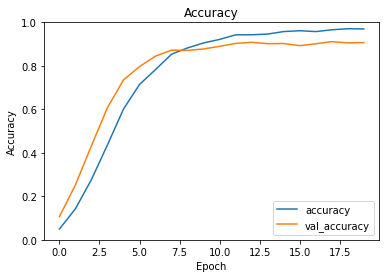

In [20]:
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0, 1])
plt.legend(loc='lower right')

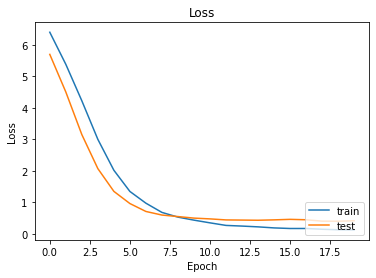

In [21]:
plt.title('Loss')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='lower right')

In [22]:
# plt.title('Precision')
# plt.plot(history.history['precision'], label='precision')
# plt.plot(history.history['val_precision'], label = 'val_precision')
# plt.xlabel('Epoch')
# plt.ylabel('Precision')
# # plt.ylim([0, 1])
# plt.legend(loc='lower right')

In [23]:
# plt.title('Recall')
# plt.plot(history.history['recall'], label='recall')
# plt.plot(history.history['val_recall'], label = 'val_recall')
# plt.xlabel('Epoch')
# plt.ylabel('Recall')
# # plt.ylim([0, 1])
# plt.legend(loc='lower right')

In [24]:
# plt.title('AUC')
# plt.plot(history.history['auc'], label='auc')
# plt.plot(history.history['val_auc'], label = 'val_auc')
# plt.xlabel('Epoch')
# plt.ylabel('AUC')
# # plt.ylim([0, 1])
# plt.legend(loc='lower right')

In [25]:
# 存/取模型
# model.save('/model in 6.CNN with more databy pad and flip') 
# loaded_model = tf.keras.models.load_model('/tmp/model') 

In [26]:
import matplotlib.pyplot as plot  # plot 可以視為畫布
import math

def show_feature_label_prediction(features, labels, predictions, indexList):
    num = len(indexList)

    plot.gcf().set_size_inches( 2*5, (2+0.4)*math.ceil(num/5) )

    loc = 0
    for i in indexList :
        loc += 1
        subp = plot.subplot( math.ceil(num/5), 5, loc )
        subp.imshow( features[i], cmap='binary' )

        if( len(predictions) > 0 ) :
            title = 'prediction = ' + str(predictions[i])
            title += (' (o)' if predictions[i]==labels[i] else ' (x)') # predict result
            title += '\nlabel = ' + str(labels[i])
        else :
            title = 'label = ' + str(labels[i])

        subp.set_title( title, fontsize=12 )
        subp.set_xticks( [] )
        subp.set_yticks( [] )
    plot.show()

In [33]:
def show_misprediction(features, labels, predictions, indexList):
    num = len(indexList)

    plot.gcf().set_size_inches( 2*5, (2+0.4)*math.ceil(num/5) )

    loc = 0
    for i in indexList :

        if(len(predictions)> 0) & (predictions[i]!=labels[i]):
            loc += 1
            subp = plot.subplot( math.ceil(num/5), 5, loc )
            subp.imshow(features[i], cmap='binary' )
#             title = str(labels[i])
            title = 'prediction = ' + str(predictions[i])
            title += (' (o)' if predictions[i]==labels[i] else ' (x)') # predict result
            title += '\nlabel = ' + str(labels[i])
            subp.set_title( title, fontsize=12 )
        else :
            continue
#             title = 'label = ' + str(labels[i])

        
        subp.set_xticks( [] )
        subp.set_yticks( [] )
    plot.show()

In [28]:
re = []
prediction = np.argmax(model.predict(test_images),axis=1)
for i in range(len(test_labels_org)):
    if prediction[i]!=test_labels_org[i]:
        re.append(test_labels_org[i])
# sorted(re)

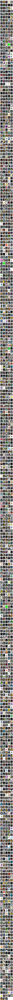

In [29]:
# prediction = model.predict_classes(test_images)
show_feature_label_prediction(test_images, test_labels_org, prediction, range(0, len(test_labels_org)))

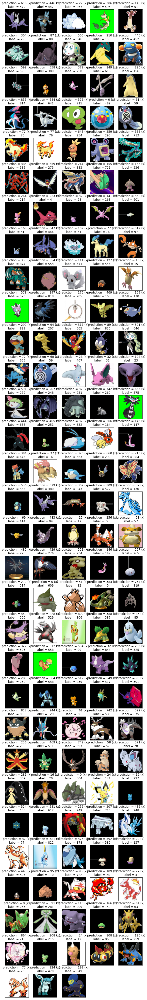

In [34]:
# prediction = model.predict_classes(test_images)
show_misprediction(test_images, test_labels_org, prediction, range(0, len(test_labels_org)))

In [31]:
df = pd.DataFrame(data={'name': np.unique(list(name_list))})
df

,name
0,001_Bulbasaur
1,002_Ivysaur
2,003_Venusaur
3,004_Charmander
4,005_Charmeleon
...,...
881,886_Drakloak
882,887_Dragapult
883,888_Zacian
884,889_Zamazenta


In [32]:
print(df.iloc[3][0])

004_Charmander
